In [43]:
# these packages are used in our analysis
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.stats as stats
from sklearn.linear_model import LinearRegression
from sklearn.neighbors import KNeighborsClassifier

import pylab
import math
from math import log

import folium

import pylab as plot
import numpy as np

from sklearn.dummy import DummyClassifier
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV

import sklearn
import sklearn.metrics as metrics
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import cross_validate
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import RandomForestClassifier
from sklearn import tree
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn import metrics
from sklearn import datasets
from sklearn import linear_model
from sklearn import ensemble


from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import PolynomialFeatures
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import cross_validate
import geopy.distance as geo
import datetime
import statsmodels.api as sm
from statsmodels.formula.api import ols
from sklearn.dummy import DummyRegressor
from IPython import display
from sklearn.metrics import r2_score
from statsmodels.tools.eval_measures import rmse
from IPython.display import Image
%matplotlib inline

from sklearn.tree import DecisionTreeClassifier

from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler
from collections import Counter
from numpy import where
from sklearn.metrics import plot_confusion_matrix
from sklearn.metrics import confusion_matrix, plot_confusion_matrix,\
    precision_score, recall_score, accuracy_score, f1_score, log_loss,\
    roc_curve, roc_auc_score, classification_report
from sklearn.preprocessing import OrdinalEncoder
from sklearn.metrics import plot_roc_curve

In [44]:
df = pd.read_csv('listings.csv')
df.info()

/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3145: DtypeWarning: Columns (67) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 38277 entries, 0 to 38276
Data columns (total 74 columns):
 #   Column                                        Non-Null Count  Dtype  
---  ------                                        --------------  -----  
 0   id                                            38277 non-null  int64  
 1   listing_url                                   38277 non-null  object 
 2   scrape_id                                     38277 non-null  int64  
 3   last_scraped                                  38277 non-null  object 
 4   name                                          38264 non-null  object 
 5   description                                   37085 non-null  object 
 6   neighborhood_overview                         22650 non-null  object 
 7   picture_url                                   38277 non-null  object 
 8   host_id                                       38277 non-null  int64  
 9   host_url                                      38277 non-null 

In [45]:
df.amenities

0        ["Extra pillows and blankets", "Baking sheet",...
1        ["Extra pillows and blankets", "Luggage dropof...
2        ["Kitchen", "Long term stays allowed", "Wifi",...
3        ["Kitchen", "BBQ grill", "Cable TV", "Carbon m...
4        ["Room-darkening shades", "Lock on bedroom doo...
                               ...                        
38272    ["Fire extinguisher", "Cooking basics", "Carbo...
38273    ["Fire extinguisher", "Cooking basics", "Carbo...
38274    ["Hangers", "Long term stays allowed", "Fire e...
38275    ["Hangers", "Long term stays allowed", "Fire e...
38276    ["Stainless steel electric stove", "Security c...
Name: amenities, Length: 38277, dtype: object

In [46]:
#Finding only important features
df2 = df[['id','host_id','longitude','latitude','property_type','room_type','accommodates','bedrooms','beds','price','number_of_reviews','review_scores_rating', 'review_scores_accuracy','review_scores_cleanliness','review_scores_checkin','review_scores_communication','review_scores_location','review_scores_value','calculated_host_listings_count','neighbourhood_group_cleansed','availability_30','minimum_nights','first_review']]

In [47]:
df2

,id,host_id,longitude,latitude,property_type,room_type,accommodates,bedrooms,beds,price,...,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,calculated_host_listings_count,neighbourhood_group_cleansed,availability_30,minimum_nights,first_review
0,2595,2845,-73.985590,40.753560,Entire rental unit,Entire home/apt,1,NaN,1.0,$150.00,...,4.62,4.76,4.79,4.86,4.41,3,Manhattan,3,30,2009-11-21
1,3831,4869,-73.957650,40.684940,Entire guest suite,Entire home/apt,3,1.0,3.0,$75.00,...,4.49,4.78,4.80,4.71,4.64,1,Brooklyn,3,1,2015-01-05
2,5121,7356,-73.955120,40.685350,Private room in rental unit,Private room,2,1.0,1.0,$60.00,...,4.09,4.91,4.91,4.47,4.52,2,Brooklyn,30,30,2014-01-22
3,5136,7378,-73.994540,40.662650,Entire rental unit,Entire home/apt,4,2.0,2.0,$275.00,...,5.00,5.00,5.00,4.50,5.00,1,Brooklyn,3,5,2014-01-02
4,5178,8967,-73.983170,40.764570,Private room in rental unit,Private room,2,1.0,1.0,$68.00,...,3.73,4.66,4.42,4.87,4.36,1,Manhattan,1,2,2010-08-18
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38272,53662330,100146245,-74.136715,40.632222,Private room in residential home,Private room,2,1.0,NaN,$79.00,...,NaN,NaN,NaN,NaN,NaN,6,Staten Island,24,1,NaN
38273,53662542,100146245,-74.136142,40.630502,Private room in residential home,Private room,2,1.0,NaN,$76.00,...,NaN,NaN,NaN,NaN,NaN,6,Staten Island,24,1,NaN
38274,53662772,337879004,-73.980536,40.753887,Private room in serviced apartment,Private room,2,1.0,1.0,$116.00,...,NaN,NaN,NaN,NaN,NaN,13,Manhattan,11,1,NaN
38275,53663081,337879004,-73.981976,40.755569,Private room in serviced apartment,Private room,2,1.0,1.0,$106.00,...,NaN,NaN,NaN,NaN,NaN,13,Manhattan,3,1,NaN


In [48]:
#Number of Missing Values
df2.isna().sum()

id                                    0
host_id                               0
longitude                             0
latitude                              0
property_type                         0
room_type                             0
accommodates                          0
bedrooms                           3975
beds                               2405
price                                 0
number_of_reviews                     0
review_scores_rating               9504
review_scores_accuracy            10116
review_scores_cleanliness         10105
review_scores_checkin             10123
review_scores_communication       10112
review_scores_location            10126
review_scores_value               10127
calculated_host_listings_count        0
neighbourhood_group_cleansed          0
availability_30                       0
minimum_nights                        0
first_review                       9504
dtype: int64

In [49]:
df2['price'] = (df2['price'].str.replace(r'[^-+\d.]', '').astype(float))

<ipython-input-49-fa14d3eccbed>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2['price'] = (df2['price'].str.replace(r'[^-+\d.]', '').astype(float))


In [50]:
df2['review_scores_rating'].value_counts()

5.00    8721
4.00    1193
4.50    1106
4.67     903
4.75     728
        ... 
3.30       1
3.55       1
3.81       1
3.58       1
2.89       1
Name: review_scores_rating, Length: 156, dtype: int64

### Map

In [51]:
mapdf = df2[['latitude','longitude','price']]

In [52]:
mapdf

,latitude,longitude,price
0,40.753560,-73.985590,150.0
1,40.684940,-73.957650,75.0
2,40.685350,-73.955120,60.0
3,40.662650,-73.994540,275.0
4,40.764570,-73.983170,68.0
...,...,...,...
38272,40.632222,-74.136715,79.0
38273,40.630502,-74.136142,76.0
38274,40.753887,-73.980536,116.0
38275,40.755569,-73.981976,106.0


In [53]:
mapdf.latitude.min()

40.50456

In [54]:
mapdf.latitude.max()

40.91402

In [55]:
mapdf.longitude.min()

-74.24984

In [56]:
mapdf.longitude.max()

-73.71087

In [57]:
map = folium.Map(location=[mapdf.latitude.mean(), mapdf.longitude.mean()], zoom_start=12, control_scale=True)

In [58]:
map

In [59]:
def get_center_latlong(mapdf):
    # get the center of my map for plotting
    centerlat = (mapdf['latitude'].max() + mapdf['latitude'].min()) / 2
    centerlong = (mapdf['longitude'].max() + mapdf['longitude'].min()) / 2
    return centerlat, centerlong

In [60]:
center = get_center_latlong(mapdf)
m = folium.Map(location=center, zoom_start=10)

# go through each home in set, make circle, and add to map.
for i in range(len(mapdf)):
    folium.Circle(
        location=[mapdf.iloc[i]['latitude'], mapdf.iloc[i]['longitude']],
        radius=10,
    ).add_to(m)

# Same as before, we save it to file
m.save('circle_map.html')

In [61]:
import branca.colormap as cm

# create a LinearColorMap and assign colors, vmin, and vmax
# the colormap will show green for $100,000 homes all the way up to red for $1,500,000 homes
colormap = cm.LinearColormap(colors=['green', 'yellow'], vmin=110)

# create our map again.  This time I am using a different tileset for a new look
m = folium.Map(location=center, zoom_start=10, tiles='Stamen Toner')

# Same as before... go through each home in set, make circle, and add to map.
# This time we add a color using price and the colormap object
for i in range(len(mapdf)):
    folium.Circle(
        location=[mapdf.iloc[i]['latitude'], mapdf.iloc[i]['longitude']],
        radius=10,
        fill=True,
        color=colormap(mapdf.iloc[i]['price']),
        fill_opacity=0.2
    ).add_to(m)

# the following line adds the scale directly to our map
m.add_child(colormap)

# Save map 
m.save('mapofnyc_pricerange')

In [62]:
m

### Removing outliers 3 STD away

In [65]:
#Removing Outliers
df3 = df2[((df2['price'] - df2['price'].mean()) / df2['price'].std()).abs() < 3]

In [66]:
df3

,id,host_id,longitude,latitude,property_type,room_type,accommodates,bedrooms,beds,price,...,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,calculated_host_listings_count,neighbourhood_group_cleansed,availability_30,minimum_nights,first_review
0,2595,2845,-73.985590,40.753560,Entire rental unit,Entire home/apt,1,NaN,1.0,150.0,...,4.62,4.76,4.79,4.86,4.41,3,Manhattan,3,30,2009-11-21
1,3831,4869,-73.957650,40.684940,Entire guest suite,Entire home/apt,3,1.0,3.0,75.0,...,4.49,4.78,4.80,4.71,4.64,1,Brooklyn,3,1,2015-01-05
2,5121,7356,-73.955120,40.685350,Private room in rental unit,Private room,2,1.0,1.0,60.0,...,4.09,4.91,4.91,4.47,4.52,2,Brooklyn,30,30,2014-01-22
3,5136,7378,-73.994540,40.662650,Entire rental unit,Entire home/apt,4,2.0,2.0,275.0,...,5.00,5.00,5.00,4.50,5.00,1,Brooklyn,3,5,2014-01-02
4,5178,8967,-73.983170,40.764570,Private room in rental unit,Private room,2,1.0,1.0,68.0,...,3.73,4.66,4.42,4.87,4.36,1,Manhattan,1,2,2010-08-18
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38272,53662330,100146245,-74.136715,40.632222,Private room in residential home,Private room,2,1.0,NaN,79.0,...,NaN,NaN,NaN,NaN,NaN,6,Staten Island,24,1,NaN
38273,53662542,100146245,-74.136142,40.630502,Private room in residential home,Private room,2,1.0,NaN,76.0,...,NaN,NaN,NaN,NaN,NaN,6,Staten Island,24,1,NaN
38274,53662772,337879004,-73.980536,40.753887,Private room in serviced apartment,Private room,2,1.0,1.0,116.0,...,NaN,NaN,NaN,NaN,NaN,13,Manhattan,11,1,NaN
38275,53663081,337879004,-73.981976,40.755569,Private room in serviced apartment,Private room,2,1.0,1.0,106.0,...,NaN,NaN,NaN,NaN,NaN,13,Manhattan,3,1,NaN


<AxesSubplot:xlabel='review_scores_rating', ylabel='price'>

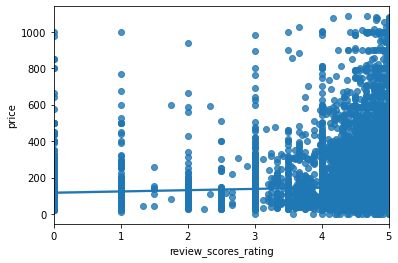

In [67]:
sns.regplot(x=df3['review_scores_rating'], y=df3["price"])

In [68]:
df3.price.value_counts()

150.0    1307
100.0    1162
50.0      906
60.0      895
75.0      823
         ... 
677.0       1
748.0       1
888.0       1
566.0       1
817.0       1
Name: price, Length: 789, dtype: int64

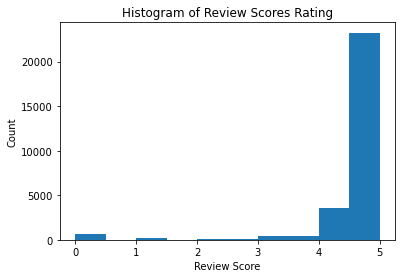

In [69]:
# visualize distribution of review scores ratings
plt.hist(df3['review_scores_rating'][~df3['review_scores_rating'].isnull()])
plt.title("Histogram of Review Scores Rating")
plt.xlabel("Review Score")
plt.ylabel("Count")
plt.show()

In [70]:
df3.review_scores_rating.mean()

4.584886597938144

In [71]:
df3.loc[df3["review_scores_rating"] >= 5, 'overall_rating'] = 'Best'
df3.loc[df3["review_scores_rating"] <= 4, 'overall_rating'] = 'below Threshold'
df3.loc[(df3["review_scores_rating"] > 4.8) & (df3["review_scores_rating"] < 5), 'overall_rating'] = 'very good'
df3.loc[(df3["review_scores_rating"] > 4.6) & (df3["review_scores_rating"] < 4.8), 'overall_rating'] = 'good'
df3.loc[(df3["review_scores_rating"] > 4.4) & (df3["review_scores_rating"] < 4.6), 'overall_rating'] = 'average'
df3.loc[(df3["review_scores_rating"] > 4) & (df3["review_scores_rating"] < 4.4), 'overall_rating'] = 'threshold'

/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/pandas/core/indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/pandas/core/indexing.py:1765: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/pandas/core/indexing.py:1765: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try

In [72]:
df3 = df3.dropna()

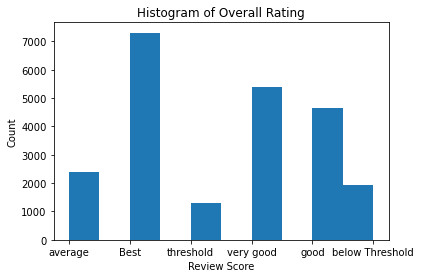

In [73]:
# visualize distribution of overall rating
plt.hist(df3['overall_rating'][~df3['overall_rating'].isnull()])
plt.title("Histogram of Overall Rating")
plt.xlabel("Review Score")
plt.ylabel("Count")
plt.show()

In [74]:
df3

,id,host_id,longitude,latitude,property_type,room_type,accommodates,bedrooms,beds,price,...,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,calculated_host_listings_count,neighbourhood_group_cleansed,availability_30,minimum_nights,first_review,overall_rating
1,3831,4869,-73.957650,40.684940,Entire guest suite,Entire home/apt,3,1.0,3.0,75.0,...,4.78,4.80,4.71,4.64,1,Brooklyn,3,1,2015-01-05,average
2,5121,7356,-73.955120,40.685350,Private room in rental unit,Private room,2,1.0,1.0,60.0,...,4.91,4.91,4.47,4.52,2,Brooklyn,30,30,2014-01-22,average
3,5136,7378,-73.994540,40.662650,Entire rental unit,Entire home/apt,4,2.0,2.0,275.0,...,5.00,5.00,4.50,5.00,1,Brooklyn,3,5,2014-01-02,Best
4,5178,8967,-73.983170,40.764570,Private room in rental unit,Private room,2,1.0,1.0,68.0,...,4.66,4.42,4.87,4.36,1,Manhattan,1,2,2010-08-18,threshold
5,5203,7490,-73.967510,40.803800,Private room in rental unit,Private room,1,1.0,1.0,75.0,...,4.97,4.95,4.94,4.92,1,Manhattan,0,2,2010-10-09,very good
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38020,53572271,164453630,-73.919143,40.866011,Private room in rental unit,Private room,2,1.0,1.0,71.0,...,5.00,5.00,5.00,5.00,1,Manhattan,9,1,2021-12-03,Best
38021,53572597,433203831,-73.924403,40.766867,Private room in bungalow,Private room,2,1.0,1.0,89.0,...,5.00,5.00,3.00,1.00,8,Queens,17,1,2021-12-04,Best
38164,53612732,420843290,-73.910910,40.678150,Private room in rental unit,Private room,2,1.0,1.0,64.0,...,1.00,5.00,5.00,2.00,7,Brooklyn,29,1,2021-12-03,below Threshold
38168,53614162,2368191,-73.929937,40.660757,Entire rental unit,Entire home/apt,3,1.0,2.0,84.0,...,5.00,5.00,5.00,5.00,3,Brooklyn,11,7,2021-12-02,Best


In [75]:
df2 = df2.dropna()

In [76]:
df2

,id,host_id,longitude,latitude,property_type,room_type,accommodates,bedrooms,beds,price,...,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,calculated_host_listings_count,neighbourhood_group_cleansed,availability_30,minimum_nights,first_review
1,3831,4869,-73.957650,40.684940,Entire guest suite,Entire home/apt,3,1.0,3.0,75.0,...,4.49,4.78,4.80,4.71,4.64,1,Brooklyn,3,1,2015-01-05
2,5121,7356,-73.955120,40.685350,Private room in rental unit,Private room,2,1.0,1.0,60.0,...,4.09,4.91,4.91,4.47,4.52,2,Brooklyn,30,30,2014-01-22
3,5136,7378,-73.994540,40.662650,Entire rental unit,Entire home/apt,4,2.0,2.0,275.0,...,5.00,5.00,5.00,4.50,5.00,1,Brooklyn,3,5,2014-01-02
4,5178,8967,-73.983170,40.764570,Private room in rental unit,Private room,2,1.0,1.0,68.0,...,3.73,4.66,4.42,4.87,4.36,1,Manhattan,1,2,2010-08-18
5,5203,7490,-73.967510,40.803800,Private room in rental unit,Private room,1,1.0,1.0,75.0,...,4.82,4.97,4.95,4.94,4.92,1,Manhattan,0,2,2010-10-09
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38021,53572597,433203831,-73.924403,40.766867,Private room in bungalow,Private room,2,1.0,1.0,89.0,...,5.00,5.00,5.00,3.00,1.00,8,Queens,17,1,2021-12-04
38153,53609786,49136387,-73.959553,40.710918,Entire rental unit,Entire home/apt,6,2.0,2.0,1980.0,...,5.00,5.00,5.00,5.00,5.00,1,Brooklyn,26,1,2021-12-02
38164,53612732,420843290,-73.910910,40.678150,Private room in rental unit,Private room,2,1.0,1.0,64.0,...,1.00,1.00,5.00,5.00,2.00,7,Brooklyn,29,1,2021-12-03
38168,53614162,2368191,-73.929937,40.660757,Entire rental unit,Entire home/apt,3,1.0,2.0,84.0,...,5.00,5.00,5.00,5.00,5.00,3,Brooklyn,11,7,2021-12-02


In [77]:
df.neighbourhood_cleansed.value_counts()

Bedford-Stuyvesant    2821
Williamsburg          2603
Harlem                1971
Hell's Kitchen        1702
Bushwick              1693
                      ... 
Castle Hill              1
Country Club             1
Lighthouse Hill          1
Graniteville             1
Neponsit                 1
Name: neighbourhood_cleansed, Length: 222, dtype: int64

In [78]:
df.describe()

,id,scrape_id,host_id,host_listings_count,host_total_listings_count,latitude,longitude,accommodates,bathrooms,bedrooms,...,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
count,3.827700e+04,3.827700e+04,3.827700e+04,38243.000000,38243.000000,38277.000000,38277.000000,38277.000000,0.0,34302.000000,...,28172.000000,28154.000000,28165.000000,28151.000000,28150.000000,38277.000000,38277.000000,38277.000000,38277.000000,28773.000000
mean,2.962239e+07,2.021120e+13,1.148305e+08,49.020056,49.020056,40.729206,-73.948967,2.792094,NaN,1.323567,...,4.612408,4.813884,4.807454,4.750307,4.646892,17.747655,8.042637,9.593934,0.047966,1.721019
std,1.742239e+07,0.000000e+00,1.299194e+08,312.947661,312.947661,0.055752,0.050759,1.869736,NaN,0.708327,...,0.575452,0.439260,0.465544,0.416101,0.518905,59.150451,34.977178,43.310123,0.426789,4.399826
min,2.595000e+03,2.021120e+13,2.438000e+03,0.000000,0.000000,40.504560,-74.249840,0.000000,NaN,1.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.010000
25%,1.341048e+07,2.021120e+13,1.139462e+07,1.000000,1.000000,40.689260,-73.983270,2.000000,NaN,1.000000,...,4.500000,4.800000,4.810000,4.670000,4.550000,1.000000,0.000000,0.000000,0.000000,0.120000
50%,3.081269e+07,2.021120e+13,5.005297e+07,1.000000,1.000000,40.725180,-73.954770,2.000000,NaN,1.000000,...,4.800000,4.960000,4.970000,4.880000,4.780000,1.000000,1.000000,0.000000,0.000000,0.480000
75%,4.642855e+07,2.021120e+13,2.002395e+08,3.000000,3.000000,40.762680,-73.930430,4.000000,NaN,1.000000,...,5.000000,5.000000,5.000000,5.000000,5.000000,3.000000,1.000000,1.000000,0.000000,1.780000
max,5.366510e+07,2.021120e+13,4.344080e+08,3750.000000,3750.000000,40.914020,-73.710870,16.000000,NaN,16.000000,...,5.000000,5.000000,5.000000,5.000000,5.000000,421.000000,308.000000,359.000000,8.000000,141.000000


### Neighborhood

In [79]:
df.neighbourhood_group_cleansed.value_counts()

Manhattan        16781
Brooklyn         14716
Queens            5323
Bronx             1104
Staten Island      353
Name: neighbourhood_group_cleansed, dtype: int64

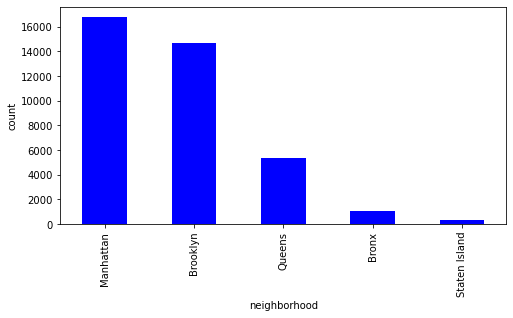

In [80]:
plt.figure(figsize=(8, 4))
df.neighbourhood_group_cleansed.value_counts().plot(kind='bar', color='b')
plt.xticks(rotation=90)
plt.ylabel('count')
plt.xlabel('neighborhood')
plt.show()

In [81]:
df.neighbourhood_cleansed.value_counts()

Bedford-Stuyvesant    2821
Williamsburg          2603
Harlem                1971
Hell's Kitchen        1702
Bushwick              1693
                      ... 
Castle Hill              1
Country Club             1
Lighthouse Hill          1
Graniteville             1
Neponsit                 1
Name: neighbourhood_cleansed, Length: 222, dtype: int64

In [162]:
groupedby_hood = df.groupby('neighbourhood_cleansed')
hood_mean = groupedby_hood.mean()[['price']]

# Neighbourhood with highest rates
price_sorted = hood_mean.sort_values(by=['price'], ascending=False).round(2).head(40)

sns.set(rc={'figure.figsize':(11.7,8.27)})

display(price_sorted.head(10))

price_graph = sns.barplot(x=price_sorted.index, y=price_sorted.price)
price_graph.set_xticklabels(labels=price_graph.get_xticklabels(), rotation=90);
price_graph.set_xlabel('Neighbourhood');
price_graph.set_ylabel('Average Price per Listing');

KeyError: "None of [Index(['price'], dtype='object')] are in the [columns]"

In [ ]:
doc_df = df[(df['doctor_recc_seasonal'] == 0) & (df['price_range'] == 1)]

In [82]:
import wordcloud
from wordcloud import WordCloud, STOPWORDS

In [83]:
stopwords = set(STOPWORDS)
def show_wordcloud(data, title = None):
    wordcloud = WordCloud(
        background_color='white',
        stopwords=stopwords,
        max_words=500,
        max_font_size=30, 
        scale=3,
        random_state=1 # chosen at random by flipping a coin; it was heads
    ).generate(str(data))
    
    fig = plt.figure(1, figsize=(8, 8))
    plt.axis('off')
    if title: 
        fig.suptitle(title, fontsize=20)
        fig.subplots_adjust(top=2.3)

    plt.imshow(wordcloud)
    plt.show()

In [84]:
summaryDF = df[['description','price']]
summaryDF = summaryDF[pd.notnull(summaryDF['description'])]
summaryDF = summaryDF[summaryDF['description']!=0]

summaryDF = summaryDF.sort_values('price',ascending=[0])
top100DF = summaryDF.head(100)
top100DF.head()

,description,price
35688,"No worries about drinking and driving, you can...",$999.00
5172,"Celebrity owned and designed, loft-style HOME ...",$999.00
28558,You can party like its 1999. Large private spa...,$999.00
20477,Marriott Vacation Club Pulse NYC<br />In the h...,$999.00
16718,Experience unparalleled luxury at our iconic f...,$999.00


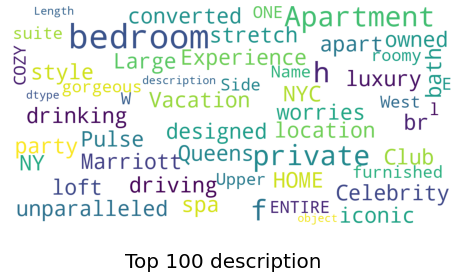

In [85]:
show_wordcloud(top100DF["description"] , title = "Top 100 description")


/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/seaborn/axisgrid.py:1912: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


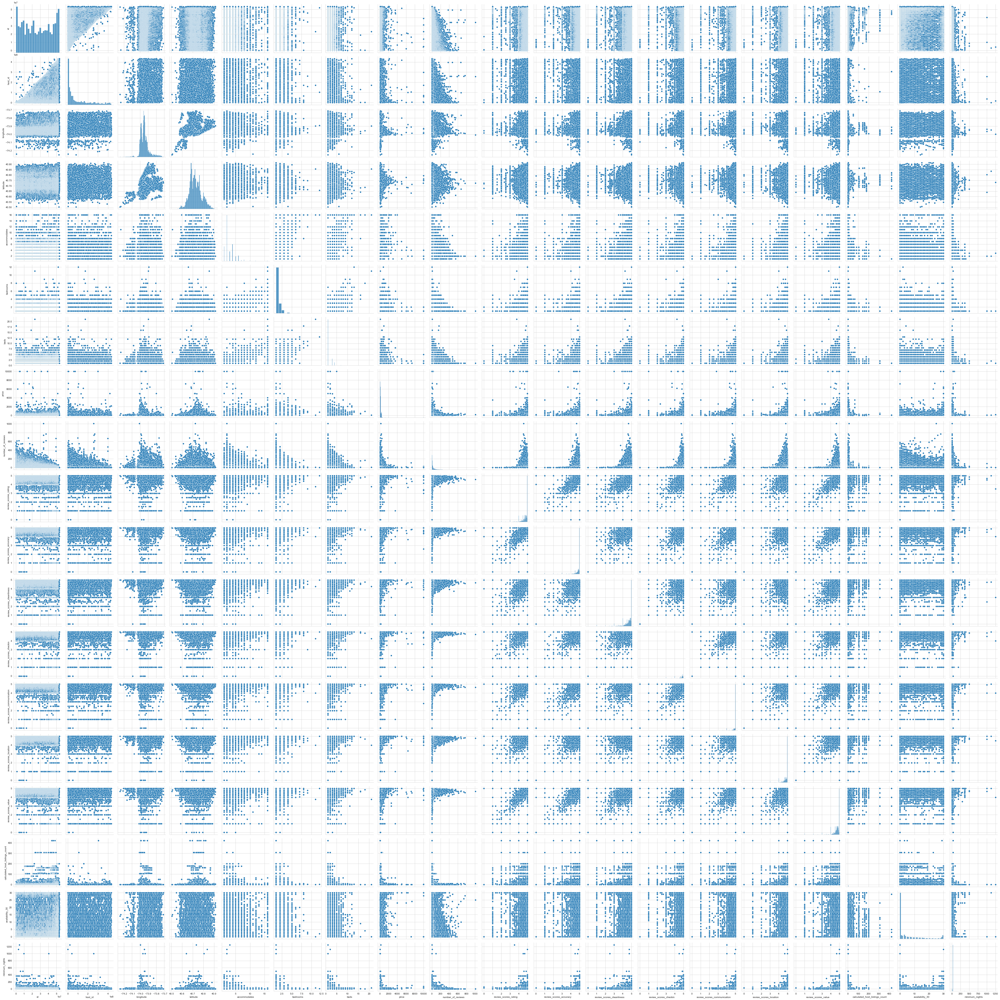

In [86]:
#Plot pairwise relationships in the dataset
sns.set_style("whitegrid");
sns.pairplot(df2, palette='rainbow', size=3);
plt.show()

In [87]:
review_count_dates = pd.to_datetime(df2['first_review']).value_counts().resample('D').mean().fillna(0)

Text(0, 0.5, 'first_review')

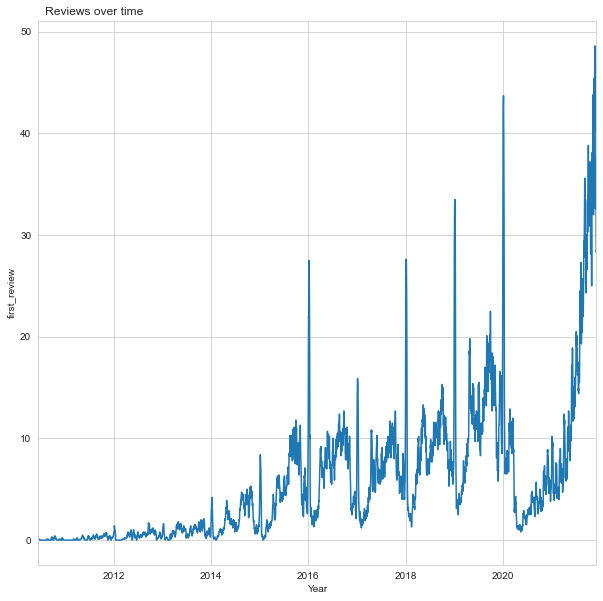

In [88]:
fig = plt.figure(1, figsize=(10,10))
ax = fig.add_subplot(111)
ax.grid(True)
review_count_dates.rolling(window=10).mean().plot(ax=ax, title = 'Reviews over time')

ax.set_title(ax.get_title())
ax.title.set_position((0.1,1.04))

xlab = 'Year'
ax.set_xlabel(xlab)

ylab = 'first_review'
ax.set_ylabel(ylab)

In [89]:
Accomodations = df2.pivot_table(index='property_type', columns= 'room_type', values='accommodates' ,aggfunc=np.sum,fill_value=0)

In [90]:
Accomodations

room_type,Entire home/apt,Hotel room,Private room,Shared room
property_type,,,,
Barn,5,0,0,0
Boat,25,0,0,0
Camper/RV,21,0,0,0
Casa particular,4,0,0,0
Cave,4,0,0,0
...,...,...,...,...
Shared room in rental unit,0,0,0,436
Shared room in residential home,0,0,0,91
Shared room in serviced apartment,0,0,0,2


(0.0, 4000.0)

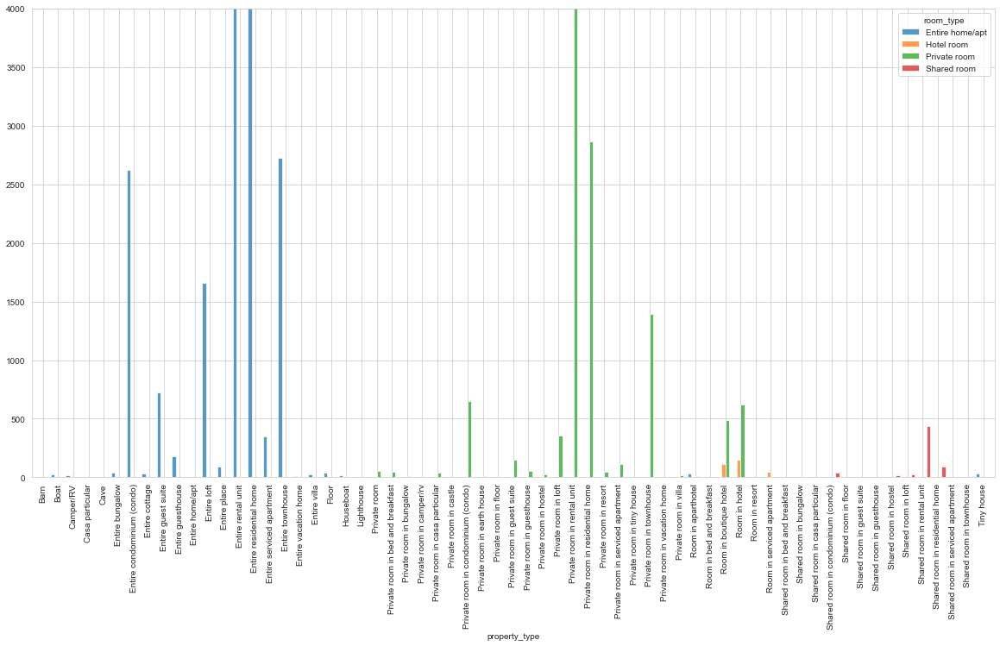

In [91]:
#plot.axis([0, 10, 0, 20])
Accomodations.plot.bar(figsize=(20,10),width=1, alpha=.75).axes.set_ylim([0,4000])

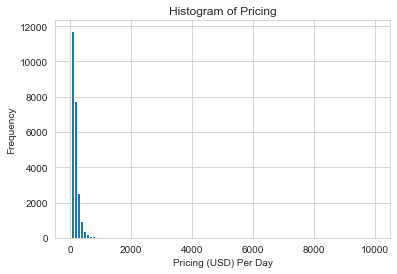

In [92]:
# visualize distribution of price (target variable)
plt.hist(df2['price'], bins=100)
plt.title("Histogram of Pricing")
plt.xlabel("Pricing (USD) Per Day")
plt.ylabel("Frequency")
plt.show()

In [93]:
print('Most expensive accomodations :', np.max(df2['price']))#To get the maximum price
print('The major chunk revollves around the price :',np.percentile(df2['price'],97))#The overexpensive accomodations are only in top 3%

Most expensive accomodations : 10000.0
The major chunk revollves around the price : 504.0


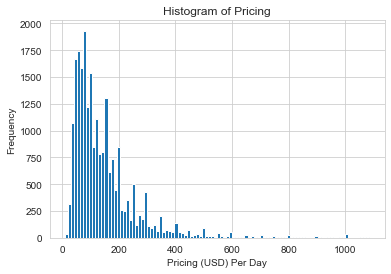

In [94]:
# visualize distribution of price (target variable)
plt.hist(df3['price'], bins=100)
plt.title("Histogram of Pricing")
plt.xlabel("Pricing (USD) Per Day")
plt.ylabel("Frequency")
plt.show()

In [95]:
df3.price.mean()

149.12020382387527

In [96]:
df3.price.median()

110.0

In [97]:
df3.loc[df3["price"] >= 110, 'price_range'] = '1'
df3.loc[df3["price"] < 110, 'price_range'] = '0'

/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/pandas/core/indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/pandas/core/indexing.py:1765: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value)
/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/pandas/core/indexing.py:1765: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try

In [98]:
df3.room_type.value_counts()

Entire home/apt    12108
Private room       10414
Shared room          323
Hotel room           116
Name: room_type, dtype: int64

### One Hot Encoding

In [99]:
ohe_df = pd.get_dummies(df3, columns = ['room_type','neighbourhood_group_cleansed'])
ohe_df.head()

,id,host_id,longitude,latitude,property_type,accommodates,bedrooms,beds,price,number_of_reviews,...,price_range,room_type_Entire home/apt,room_type_Hotel room,room_type_Private room,room_type_Shared room,neighbourhood_group_cleansed_Bronx,neighbourhood_group_cleansed_Brooklyn,neighbourhood_group_cleansed_Manhattan,neighbourhood_group_cleansed_Queens,neighbourhood_group_cleansed_Staten Island
1,3831,4869,-73.95765,40.68494,Entire guest suite,3,1.0,3.0,75.0,409,...,0,1,0,0,0,0,1,0,0,0
2,5121,7356,-73.95512,40.68535,Private room in rental unit,2,1.0,1.0,60.0,50,...,0,0,0,1,0,0,1,0,0,0
3,5136,7378,-73.99454,40.66265,Entire rental unit,4,2.0,2.0,275.0,2,...,1,1,0,0,0,0,1,0,0,0
4,5178,8967,-73.98317,40.76457,Private room in rental unit,2,1.0,1.0,68.0,507,...,0,0,0,1,0,0,0,1,0,0
5,5203,7490,-73.96751,40.80380,Private room in rental unit,1,1.0,1.0,75.0,118,...,0,0,0,1,0,0,0,1,0,0


In [100]:
df4 = ohe_df.drop(labels=['id', 'host_id', 'longitude', 'latitude', 'property_type',
       'accommodates','price','calculated_host_listings_count','first_review',
       'overall_rating'], axis=1)

In [101]:
ohe_df

,id,host_id,longitude,latitude,property_type,accommodates,bedrooms,beds,price,number_of_reviews,...,price_range,room_type_Entire home/apt,room_type_Hotel room,room_type_Private room,room_type_Shared room,neighbourhood_group_cleansed_Bronx,neighbourhood_group_cleansed_Brooklyn,neighbourhood_group_cleansed_Manhattan,neighbourhood_group_cleansed_Queens,neighbourhood_group_cleansed_Staten Island
1,3831,4869,-73.957650,40.684940,Entire guest suite,3,1.0,3.0,75.0,409,...,0,1,0,0,0,0,1,0,0,0
2,5121,7356,-73.955120,40.685350,Private room in rental unit,2,1.0,1.0,60.0,50,...,0,0,0,1,0,0,1,0,0,0
3,5136,7378,-73.994540,40.662650,Entire rental unit,4,2.0,2.0,275.0,2,...,1,1,0,0,0,0,1,0,0,0
4,5178,8967,-73.983170,40.764570,Private room in rental unit,2,1.0,1.0,68.0,507,...,0,0,0,1,0,0,0,1,0,0
5,5203,7490,-73.967510,40.803800,Private room in rental unit,1,1.0,1.0,75.0,118,...,0,0,0,1,0,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38020,53572271,164453630,-73.919143,40.866011,Private room in rental unit,2,1.0,1.0,71.0,1,...,0,0,0,1,0,0,0,1,0,0
38021,53572597,433203831,-73.924403,40.766867,Private room in bungalow,2,1.0,1.0,89.0,1,...,0,0,0,1,0,0,0,0,1,0
38164,53612732,420843290,-73.910910,40.678150,Private room in rental unit,2,1.0,1.0,64.0,1,...,0,0,0,1,0,0,1,0,0,0
38168,53614162,2368191,-73.929937,40.660757,Entire rental unit,3,1.0,2.0,84.0,1,...,0,1,0,0,0,0,1,0,0,0


In [102]:
df4

,bedrooms,beds,number_of_reviews,review_scores_rating,review_scores_accuracy,review_scores_cleanliness,review_scores_checkin,review_scores_communication,review_scores_location,review_scores_value,...,price_range,room_type_Entire home/apt,room_type_Hotel room,room_type_Private room,room_type_Shared room,neighbourhood_group_cleansed_Bronx,neighbourhood_group_cleansed_Brooklyn,neighbourhood_group_cleansed_Manhattan,neighbourhood_group_cleansed_Queens,neighbourhood_group_cleansed_Staten Island
1,1.0,3.0,409,4.45,4.58,4.49,4.78,4.80,4.71,4.64,...,0,1,0,0,0,0,1,0,0,0
2,1.0,1.0,50,4.52,4.22,4.09,4.91,4.91,4.47,4.52,...,0,0,0,1,0,0,1,0,0,0
3,2.0,2.0,2,5.00,5.00,5.00,5.00,5.00,4.50,5.00,...,1,1,0,0,0,0,1,0,0,0
4,1.0,1.0,507,4.21,4.21,3.73,4.66,4.42,4.87,4.36,...,0,0,0,1,0,0,0,1,0,0
5,1.0,1.0,118,4.91,4.83,4.82,4.97,4.95,4.94,4.92,...,0,0,0,1,0,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38020,1.0,1.0,1,5.00,5.00,5.00,5.00,5.00,5.00,5.00,...,0,0,0,1,0,0,0,1,0,0
38021,1.0,1.0,1,5.00,5.00,5.00,5.00,5.00,3.00,1.00,...,0,0,0,1,0,0,0,0,1,0
38164,1.0,1.0,1,1.00,1.00,1.00,1.00,5.00,5.00,2.00,...,0,0,0,1,0,0,1,0,0,0
38168,1.0,2.0,1,5.00,5.00,5.00,5.00,5.00,5.00,5.00,...,0,1,0,0,0,0,1,0,0,0


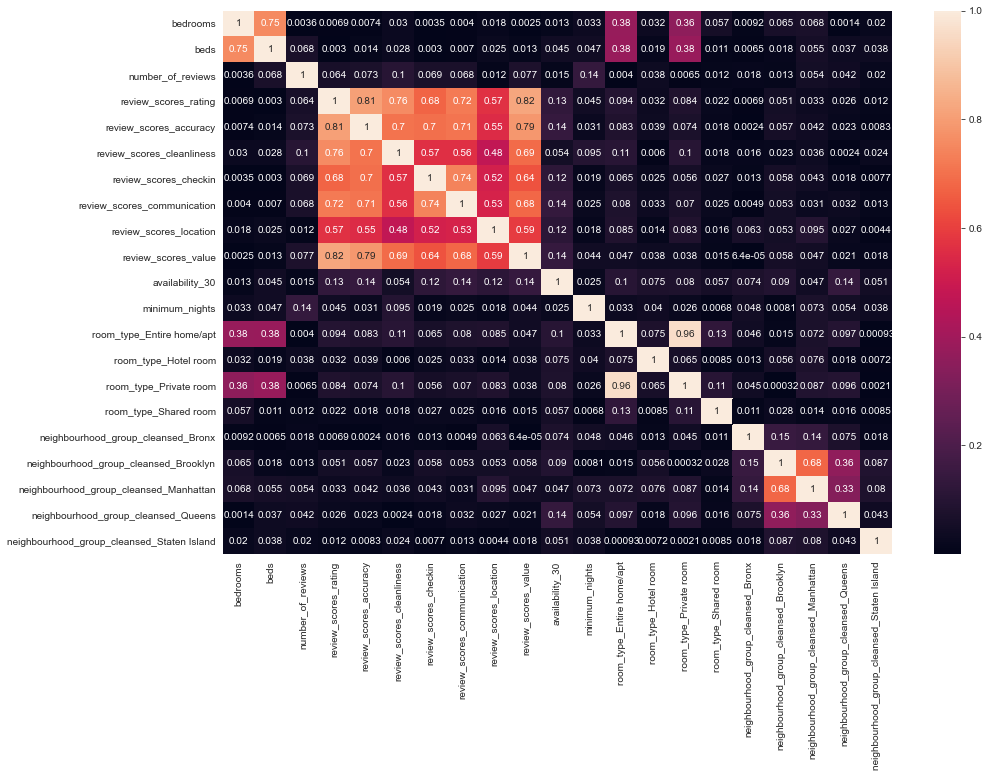

In [103]:
plt.figure(figsize = (15, 10))
sns.heatmap(df4.corr().abs(), annot = True);

### Train Test Split

In [104]:
X = df4.drop("price_range", axis=1)
y = df4["price_range"]
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=2021)

Let's start with a completely "dummy" model, that will always choose the majority class. We will use the train and test split of only numeric variables for the purposes of the dummy model.

In [105]:
dummy_model = DummyClassifier(strategy="most_frequent")

In [106]:
dummy_model.fit(X_train, y_train)

DummyClassifier(strategy='most_frequent')

In [107]:
y_pred = dummy_model.predict(X_train)
y_pred

array(['1', '1', '1', ..., '1', '1', '1'], dtype='<U1')

In [108]:
cv_results = cross_val_score(dummy_model, X_train, y_train, cv=5)
cv_results

array([0.50929152, 0.50929152, 0.50929152, 0.50929152, 0.50958188])

In [109]:
precision_score(y_train, y_pred, pos_label='1')

0.509349593495935

In [110]:
#sourced from the classification_workflow repo
class ModelWithCV():
    '''Structure to save the model and more easily see its crossvalidation'''
    
    def __init__(self, model, model_name, X, y, cv_now=True):
        self.model = model
        self.name = model_name
        self.X = X
        self.y = y
        # For CV results
        self.cv_results = None
        self.cv_mean = None
        self.cv_median = None
        self.cv_std = None
        #
        if cv_now:
            self.cross_validate()
        
    def cross_validate(self, X=None, y=None, kfolds=10):
        '''
        Perform cross-validation and return results.
        
        Args: 
          X:
            Optional; Training data to perform CV on. Otherwise use X from object
          y:
            Optional; Training data to perform CV on. Otherwise use y from object
          kfolds:
            Optional; Number of folds for CV (default is 10)  
        '''
        
        cv_X = X if X else self.X
        cv_y = y if y else self.y

        self.cv_results = cross_val_score(self.model, cv_X, cv_y, cv=kfolds)
        self.cv_mean = np.mean(self.cv_results)
        self.cv_median = np.median(self.cv_results)
        self.cv_std = np.std(self.cv_results)

        
    def print_cv_summary(self):
        cv_summary = (
        f'''CV Results for `{self.name}` model:
            {self.cv_mean:.5f} ± {self.cv_std:.5f} accuracy
        ''')
        print(cv_summary)

        
    def plot_cv(self, ax):
        '''
        Plot the cross-validation values using the array of results and given 
        Axis for plotting.
        '''
        ax.set_title(f'CV Results for `{self.name}` Model')
        # Thinner violinplot with higher bw
        sns.violinplot(y=self.cv_results, ax=ax, bw=.4)
        sns.swarmplot(
                y=self.cv_results,
                color='orange',
                size=10,
                alpha= 0.8,
                ax=ax
        )

        return ax

In [111]:
dummy_model_results = ModelWithCV(
                        model=dummy_model,
                        model_name='dummy',
                        X=X_train, 
                        y=y_train)

CV Results for `dummy` model:
            0.50935 ± 0.00017 accuracy
        


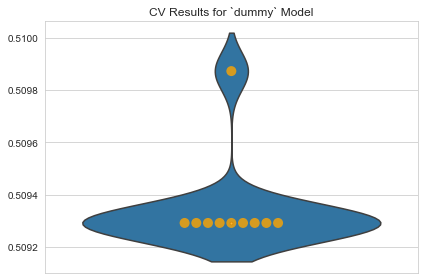

In [112]:
fig, ax = plt.subplots()

ax = dummy_model_results.plot_cv(ax)
plt.tight_layout();

dummy_model_results.print_cv_summary()

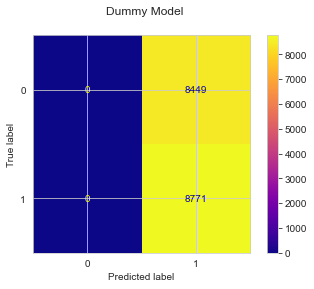

In [113]:
fig, ax = plt.subplots()

fig.suptitle("Dummy Model")

plot_confusion_matrix(dummy_model, X_train, y_train, ax=ax, cmap="plasma");

In [114]:
confusion_matrix(y_train, dummy_model.predict(X_train))

array([[   0, 8449],
       [   0, 8771]])

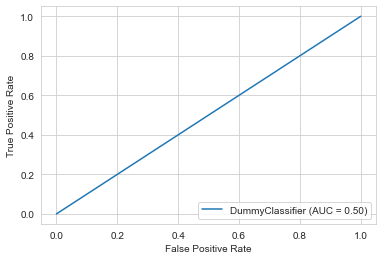

In [115]:
plot_roc_curve(dummy_model, X_train, y_train);

### Logistic Regression

In [116]:
simple_logreg_model = LogisticRegression(random_state=2021, penalty='none')

In [117]:
simple_logreg_model.fit(X_train, y_train)

/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:762: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LogisticRegression(penalty='none', random_state=2021)

In [118]:
y_pred = simple_logreg_model.predict(X_train)
y_pred

array(['0', '0', '1', ..., '0', '1', '0'], dtype=object)

In [119]:
cv_results = cross_val_score(simple_logreg_model, X_train, y_train, cv=5)
cv_results.mean()

/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:762: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:762: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html

0.8230545876887341

In [120]:
precision_score(y_train, y_pred, pos_label='1')

0.8144443223040563

In [121]:
simple_logreg_results = ModelWithCV(
                        model=simple_logreg_model,
                        model_name='simple_logreg',
                        X=X_train, 
                        y=y_train
)

/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:762: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/opt/anaconda3/envs/learn-env/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:762: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html

CV Results for `simple_logreg` model:
            0.82381 ± 0.00516 accuracy
        


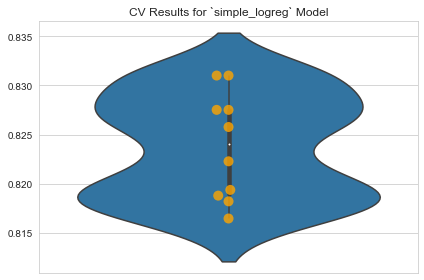

In [122]:
# Saving variable for convenience
model_results = simple_logreg_results

# Plot CV results
fig, ax = plt.subplots()
ax = model_results.plot_cv(ax)
plt.tight_layout();
# Print CV results
model_results.print_cv_summary()

In [123]:
confusion_matrix(y_train, simple_logreg_model.predict(X_train))

array([[6761, 1688],
       [1362, 7409]])

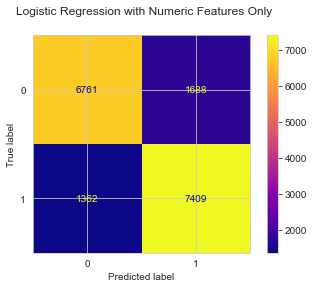

In [124]:
fig, ax = plt.subplots()

fig.suptitle("Logistic Regression with Numeric Features Only")

plot_confusion_matrix(simple_logreg_model, X_train, y_train, ax=ax, cmap="plasma");

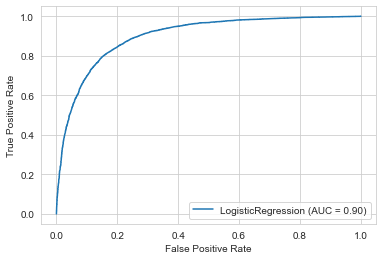

In [125]:
plot_roc_curve(simple_logreg_model, X_train, y_train)

# Decision Tree

In [126]:
ct = DecisionTreeClassifier(max_depth=2, random_state=42)

ct.fit(X_train, y_train)

DecisionTreeClassifier(max_depth=2, random_state=42)

In [127]:
#Return the mean accuracy on the given test data and labels.
ct.score(X_test, y_test)

0.8029959937293154

In [128]:
# Define the parameter grid
param_dict ={"max_depth":range(1,10),
             "min_samples_split":[10,50,100,500],"min_samples_leaf":[10,50,100,500]}

In [129]:
# Initialize the grid search object with five-fold cross-validation
gs = GridSearchCV(ct, param_grid=param_dict, cv=5,verbose=1,n_jobs=-1)

In [130]:
gs.fit(X_train, y_train)

Fitting 5 folds for each of 144 candidates, totalling 720 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:    8.7s
[Parallel(n_jobs=-1)]: Done 184 tasks      | elapsed:   13.0s
[Parallel(n_jobs=-1)]: Done 434 tasks      | elapsed:   24.8s
[Parallel(n_jobs=-1)]: Done 720 out of 720 | elapsed:   33.4s finished


GridSearchCV(cv=5,
             estimator=DecisionTreeClassifier(max_depth=2, random_state=42),
             n_jobs=-1,
             param_grid={'max_depth': range(1, 10),
                         'min_samples_leaf': [10, 50, 100, 500],
                         'min_samples_split': [10, 50, 100, 500]},
             verbose=1)

In [131]:
#best parameters calculated by the GridSearchCV
gs.best_params_

{'max_depth': 7, 'min_samples_leaf': 10, 'min_samples_split': 50}

In [132]:
gs.best_score_

0.8302555168408826

In [133]:
gs.best_estimator_.score(X_test, y_test)

0.823201532834001

In [134]:
gs.cv_results_

{'mean_fit_time': array([0.16151748, 0.12901568, 0.10177135, 0.07718034, 0.09414005,
        0.108848  , 0.08768606, 0.08670287, 0.09210448, 0.15454659,
        0.10971298, 0.13091121, 0.15582004, 0.14714031, 0.13092036,
        0.11277714, 0.12237558, 0.11811147, 0.10556746, 0.11453342,
        0.1133255 , 0.08565884, 0.09577947, 0.12272615, 0.09824963,
        0.10749121, 0.10429182, 0.09328051, 0.11301208, 0.12997694,
        0.12902622, 0.09548583, 0.11402016, 0.12152829, 0.14282513,
        0.12901802, 0.11902118, 0.10707664, 0.18835926, 0.13818626,
        0.1543695 , 0.16004195, 0.17517467, 0.13113751, 0.11679945,
        0.14611425, 0.13045912, 0.11339974, 0.13534126, 0.16969876,
        0.18478513, 0.17017207, 0.15630441, 0.10278339, 0.16358781,
        0.13793521, 0.14491925, 0.13222322, 0.17934523, 0.18609152,
        0.20506005, 0.18934541, 0.17885957, 0.1717741 , 0.20616817,
        0.18861384, 0.17368746, 0.18313155, 0.17427583, 0.15259285,
        0.50588937, 0.66408024,

In [135]:
pd.DataFrame(gs.cv_results_)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_max_depth,param_min_samples_leaf,param_min_samples_split,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score
0,0.161517,0.020079,0.049179,0.009115,1,10,10,"{'max_depth': 1, 'min_samples_leaf': 10, 'min_...",0.807491,0.808653,0.802265,0.807201,0.812427,0.807607,0.003257,113
1,0.129016,0.045600,0.042841,0.009442,1,10,50,"{'max_depth': 1, 'min_samples_leaf': 10, 'min_...",0.807491,0.808653,0.802265,0.807201,0.812427,0.807607,0.003257,113
2,0.101771,0.025233,0.025312,0.005778,1,10,100,"{'max_depth': 1, 'min_samples_leaf': 10, 'min_...",0.807491,0.808653,0.802265,0.807201,0.812427,0.807607,0.003257,113
3,0.077180,0.014629,0.030230,0.007182,1,10,500,"{'max_depth': 1, 'min_samples_leaf': 10, 'min_...",0.807491,0.808653,0.802265,0.807201,0.812427,0.807607,0.003257,113
4,0.094140,0.020074,0.043486,0.020208,1,50,10,"{'max_depth': 1, 'min_samples_leaf': 50, 'min_...",0.807491,0.808653,0.802265,0.807201,0.812427,0.807607,0.003257,113
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
139,0.173889,0.022620,0.025447,0.002437,9,100,500,"{'max_depth': 9, 'min_samples_leaf': 100, 'min...",0.824042,0.820267,0.826074,0.816783,0.828107,0.823055,0.004068,72
140,0.140854,0.008253,0.027079,0.002613,9,500,10,"{'max_depth': 9, 'min_samples_leaf': 500, 'min...",0.822880,0.821719,0.821138,0.821138,0.831301,0.823635,0.003885,47
141,0.142045,0.006431,0.028460,0.004681,9,500,50,"{'max_depth': 9, 'min_samples_leaf': 500, 'min...",0.822880,0.821719,0.821138,0.821138,0.831301,0.823635,0.003885,47
142,0.148774,0.009214,0.033130,0.004572,9,500,100,"{'max_depth': 9, 'min_samples_leaf': 500, 'min...",0.822880,0.821719,0.821138,0.821138,0.831301,0.823635,0.003885,47


In [136]:
#using the best parameters calculated earlier, we create a new Decision Tree model
ct2 = DecisionTreeClassifier(max_depth=7, min_samples_leaf=10, min_samples_split=50, random_state=42)

ct2.fit(X_train, y_train)

DecisionTreeClassifier(max_depth=7, min_samples_leaf=10, min_samples_split=50,
                       random_state=42)

In [137]:
y_pred = ct2.predict(X_test)
y_pred

array(['0', '1', '0', ..., '0', '1', '1'], dtype=object)

In [138]:
acc = accuracy_score(y_test, y_pred) * 100
print("Accuracy: {0}".format(acc))

Accuracy: 82.3201532834001


In [139]:
prec = precision_score(y_test, y_pred, pos_label='1') * 100
print("Precision: {0}".format(prec))

Precision: 81.59973666886108


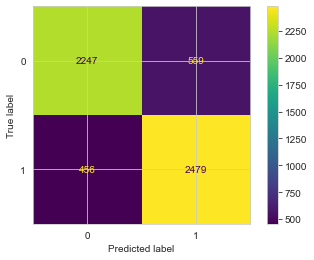

In [140]:
plot_confusion_matrix(ct2, X_test, y_test);

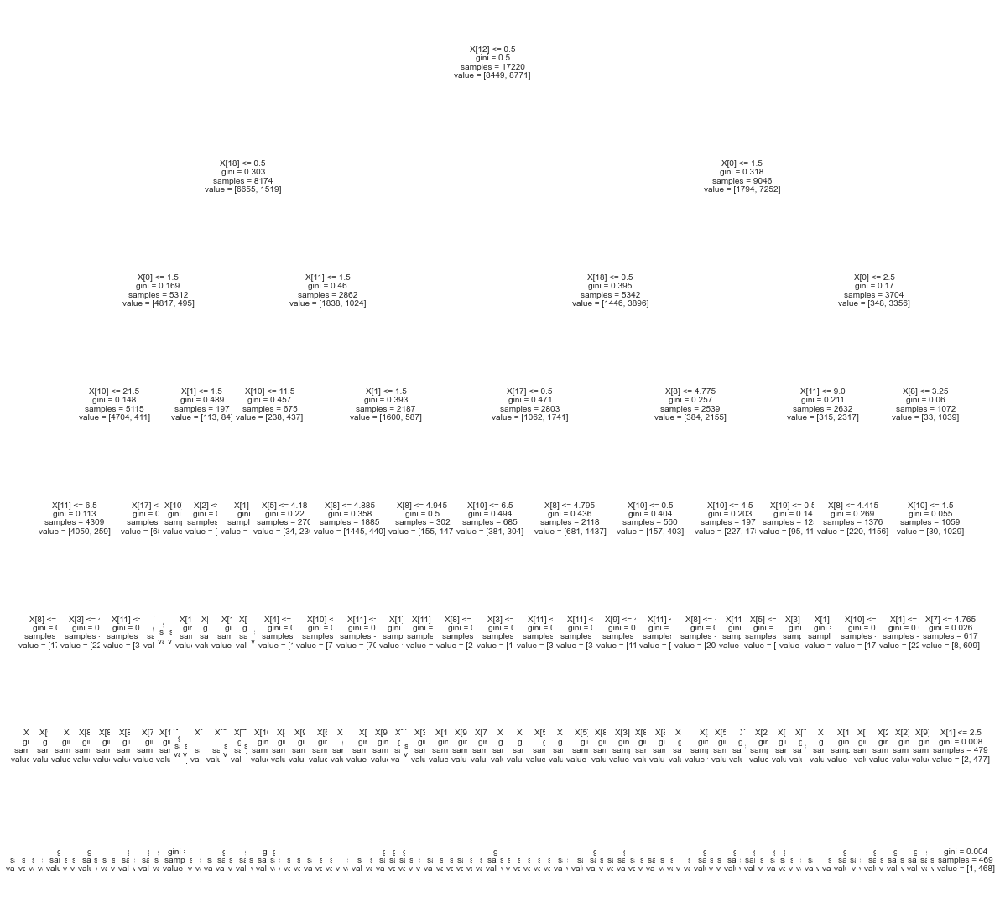

In [141]:
f, ax = plt.subplots(figsize=(20, 20))
tree.plot_tree(ct2, ax=ax, fontsize=10)
plt.show()

# Random Forest

In [142]:
my_rf = RandomForestClassifier()
my_rf.fit(X_train,y_train)

y_predict_rf = my_rf.predict(X_test)
print(y_predict_rf)

accuracy_rf = accuracy_score(y_test, y_predict_rf)

print("The accuracy is " ,"{:.1f}".format(accuracy_rf*100), "%")

['0' '1' '0' ... '1' '1' '1']
The accuracy is  82.4 %


# KNN

In [143]:
k_values = [1,3,5,7,11,15,27,50]

for x in k_values:
    k=x
    my_knn = KNeighborsClassifier(n_neighbors=k)
    my_knn.fit(X_train,y_train)
    y_predict = my_knn.predict(X_test)
    accuracy = accuracy_score(y_test,y_predict)
    print(f"For k = {k}, the accuracy is: ", "{:.1f}".format(accuracy*100), "%")

For k = 1, the accuracy is:  71.9 %
For k = 3, the accuracy is:  74.2 %
For k = 5, the accuracy is:  75.2 %
For k = 7, the accuracy is:  74.7 %
For k = 11, the accuracy is:  73.6 %
For k = 15, the accuracy is:  73.6 %
For k = 27, the accuracy is:  73.3 %
For k = 50, the accuracy is:  71.4 %


# Best Feature

[0.04409281 0.04075336 0.05999849 0.04448551 0.04071534 0.04998341
 0.03732544 0.03690643 0.05399121 0.04838754 0.05604117 0.05505053
 0.20693105 0.00489962 0.15772752 0.00809568 0.00290969 0.00839111
 0.03114094 0.01087605 0.00129711]


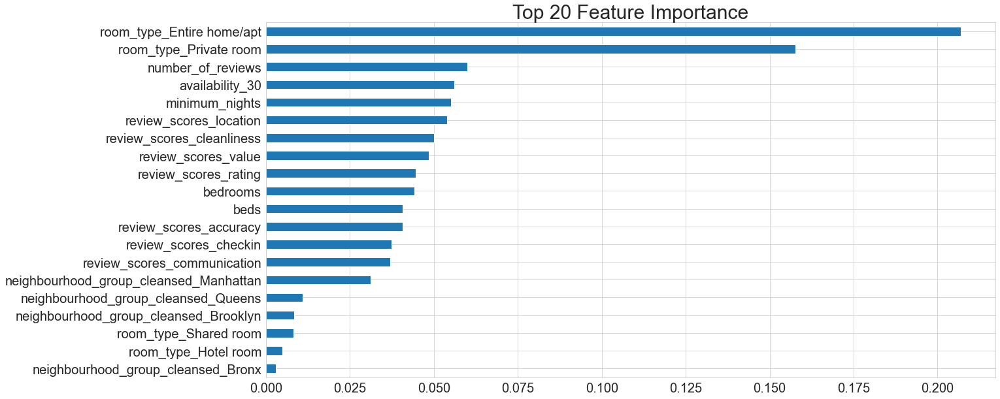

In [158]:
X = X_train
y = y_train
from sklearn.ensemble import ExtraTreesClassifier
import matplotlib.pyplot as plt
model = ExtraTreesClassifier()
model.fit(X,y)
print(model.feature_importances_)
feat_importances = pd.Series(model.feature_importances_, index=X.columns)
feat_importances.nlargest(20).sort_values(ascending=True).plot(kind='barh')
plt.title("Top 20 Feature Importance",fontsize=30)
plt.rcParams["figure.figsize"] = (20,10)
plt.yticks(fontsize=20)
plt.xticks(fontsize=20)
plt.show()

In [166]:
len(df4.columns)

22

In [145]:
df.first_review.value_counts()

2020-01-01    119
2021-11-14    118
2021-10-31    112
2019-01-01     99
2020-01-02     97
             ... 
2014-03-25      1
2012-06-27      1
2012-08-18      1
2014-04-02      1
2012-08-10      1
Name: first_review, Length: 3171, dtype: int64